# **Learning To use LIBROSA for Source Seperation**

In [1]:
import librosa
import numpy as np

# Load audio signal
file_path = "/kaggle/input/nepali-music-source-seperation/singing_voice_separation-main/Mixtures/Dev/1 (10)/mixture.wav"
signal, sr = librosa.load(file_path, sr=None, mono=False)

# 'signal' now contains the audio signal, and 'sr' is the sample rate
# Use mono=False to load all channels

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
print(type(signal))

<class 'numpy.ndarray'>


In [3]:
# Duration and length in samples
duration = librosa.get_duration(y=signal[0], sr=sr)
signal_length = len(signal[0])

# Number of channels
num_channels = signal.shape[0]

# File name and path to input file
file_name = file_path.split("/")[-1]
path_to_input_file = file_path

# Root mean square energy
rms_energy = np.sqrt(np.mean(np.square(signal)))

# Print information
print(f"Audio File: {file_name}")
print(f"Duration: {duration:.2f} seconds")
print(f"Duration in samples: {signal_length} samples")
print(f"Number of channels: {num_channels} channels")
print(f"File name: {file_name}")
print(f"Full path to input: {path_to_input_file}")
print(f"Root mean square energy: {rms_energy:.4f}")


Audio File: mixture.wav
Duration: 43.00 seconds
Duration in samples: 1896256 samples
Number of channels: 2 channels
File name: mixture.wav
Full path to input: /kaggle/input/nepali-music-source-seperation/singing_voice_separation-main/Mixtures/Dev/1 (10)/mixture.wav
Root mean square energy: 0.0903


In [4]:
from IPython.display import Audio

# Play the audio
Audio(data=signal, rate=sr)


In [5]:
signal

array([[ 0.00308228,  0.00338745,  0.00292969, ..., -0.02166748,
        -0.02392578, -0.02236938],
       [ 0.00274658,  0.00369263,  0.00253296, ..., -0.0262146 ,
        -0.02728271, -0.02584839]], dtype=float32)

In [6]:
signal.shape

(2, 1896256)

In [7]:
### Creating A Signal

# sample_rate = 44100  # Hz
# dt = 1.0 / sample_rate
# dur = 2.0  # seconds
# freq = 440  # Hz
# t = np.arange(0.0, dur, dt)
# x = np.sin(2 * np.pi * freq * t)

import numpy as np
from IPython.display import Audio

sample_rate = 44100  # Hz
duration = 2.0  # seconds
frequency = 440  # Hz

# Generate a sine wave using NumPy
t = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
x = np.sin(2 * np.pi * frequency * t)

# Play the generated audio
Audio(data=x, rate=sample_rate)


In [8]:
x


array([ 0.        ,  0.06264832,  0.12505052, ..., -0.18696144,
       -0.12505052, -0.06264832])

In [9]:
# Make the mono signal stereo by duplicating it to the left and right channels
stereo_signal = np.array([x, x])

# Adjust the stereo channels if needed (e.g., for a spatial effect)
stereo_signal[0] *= 0.5  # Adjust left channel
stereo_signal[1] *= 0.8  # Adjust right channel

# Play the generated stereo audio
Audio(data=stereo_signal[0], rate=sample_rate)

# ### adjust the left and right channels independently for a spatial effect, 
# ### you can multiply each channel by a scaling facto

# #### adjust the scaling factors or add other modifications to achieve 
# #### the desired stereo effect

In [10]:
x.shape


(88200,)

In [11]:
# Convert stereo to mono
signal1 = signal
signal2 = x

### both are either MONO or STERO
mono_signal = librosa.to_mono(signal1)
signal1 = mono_signal
print(signal1.shape)
print(signal2.shape)

# Make sure both signals have the same length and same sample rate
min_length = min(len(signal1), len(signal2))
signal1 = signal1[:min_length]
signal2 = signal2[:min_length]

# Combine the signals
signal3 = signal1 + signal2

# Play the combined audio
Audio(data=signal3, rate=sr)

(1896256,)
(88200,)


*SAVE THE AUDIO FILE*

In [12]:
!pip install soundfile

In [13]:
import soundfile as sf

# Replace "output_file_path.wav" with the desired output file path
output_file_path = "/kaggle/working/output_file.wav"

# Save the combined signal to a new audio file
sf.write(output_file_path, signal3.T, 44100)


**Time-frequency representations**

In [14]:
import librosa
import numpy as np

# Load audio signal using librosa
file_path = "/kaggle/input/nepali-music-source-seperation/singing_voice_separation-main/Mixtures/Dev/1 (10)/mixture.wav"
signal, sr = librosa.load(file_path, sr=None, mono=True)

# Compute the Short-Time Fourier Transform (STFT)
stft = librosa.stft(signal)

# Print the shape of the STFT matrix
print(stft.shape)


(1025, 3704)


In [15]:
import librosa
import inspect

# Get the signature of the stft function
sig = inspect.signature(librosa.stft)

# Print the default values from the signature
print("Default window size (n_fft):", sig.parameters['n_fft'].default)
print("Default hop length (hop_length):", sig.parameters['hop_length'].default)
print("Default window type (window):", sig.parameters['window'].default)


Default window size (n_fft): 2048
Default hop length (hop_length): None
Default window type (window): hann


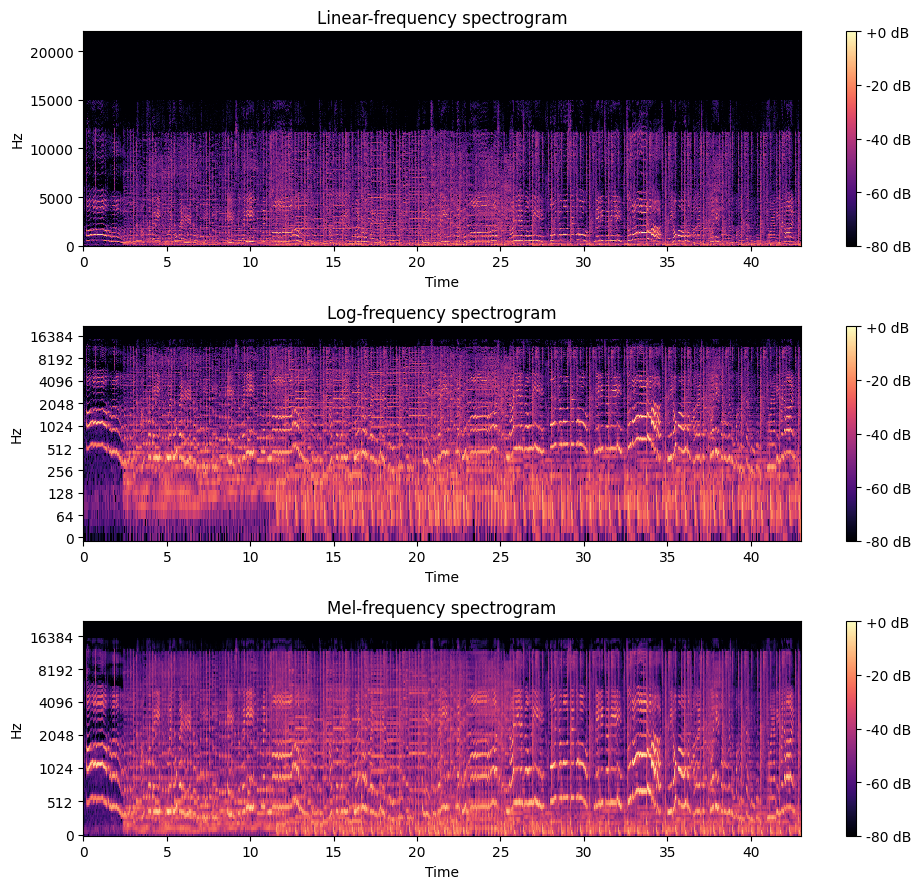

In [16]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# Load audio signal using librosa
file_path = "/kaggle/input/nepali-music-source-seperation/singing_voice_separation-main/Mixtures/Dev/1 (10)/mixture.wav"
signal, sr = librosa.load(file_path, sr=None, mono=True)

# Linear-frequency spectrogram
plt.figure(figsize=(10, 9))
plt.subplot(311)
plt.title('Linear-frequency spectrogram')
linear_spec = librosa.amplitude_to_db(np.abs(librosa.stft(signal)), ref=np.max)
librosa.display.specshow(linear_spec, sr=sr, x_axis='time', y_axis='linear')
plt.colorbar(format='%+2.0f dB')

# Log-frequency spectrogram
plt.subplot(312)
plt.title('Log-frequency spectrogram')
log_spec = librosa.amplitude_to_db(np.abs(librosa.stft(signal)), ref=np.max)
librosa.display.specshow(log_spec, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

# Mel-frequency spectrogram
plt.subplot(313)
plt.title('Mel-frequency spectrogram')
mel_spectrogram = librosa.feature.melspectrogram(y=signal, sr=sr)
mel_spec_db = librosa.power_to_db(mel_spectrogram, ref=np.max)
librosa.display.specshow(mel_spec_db, sr=sr, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()


**INVESRE STFTS**

In [17]:
import librosa
import numpy as np
import matplotlib.pyplot as plt

# Load audio signal using librosa
file_path = "/kaggle/input/nepali-music-source-seperation/singing_voice_separation-main/Mixtures/Dev/1 (10)/mixture.wav"
signal, sr = librosa.load(file_path, sr=None, mono=True)

# Compute the Short-Time Fourier Transform (STFT)
stft = librosa.stft(signal)

# Copy the STFT data
lp_stft = stft.copy()

# Low-pass cutoff frequency
lp_cutoff = 1000  # Hz

# Find the index of the closest value to the cutoff frequency
frequency_vector = librosa.fft_frequencies(sr=sr)
idx = np.argmin(np.abs(frequency_vector - lp_cutoff))

# Apply low-pass filter
lp_stft[idx:, :] = 0.0

# Inverse STFT (iSTFT)
signal_lp = librosa.istft(lp_stft)

# Play the combined audio
Audio(data=signal_lp, rate=sr)


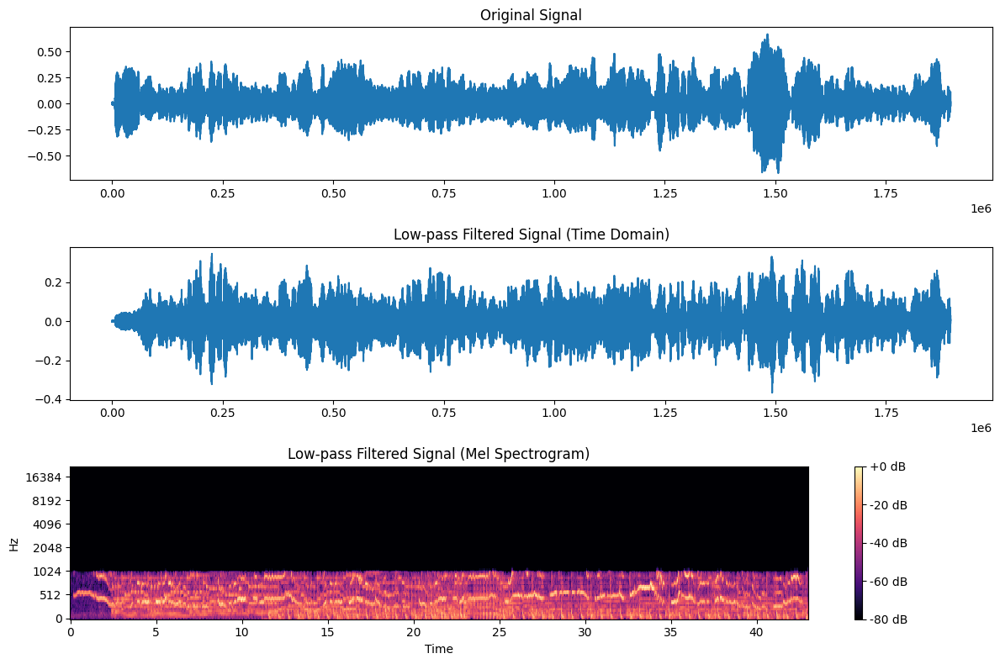

In [18]:
# Plot the original and filtered signals
plt.figure(figsize=(12, 8))

plt.subplot(3, 1, 1)
plt.title('Original Signal')
plt.plot(signal)

plt.subplot(3, 1, 2)
plt.title('Low-pass Filtered Signal (Time Domain)')
plt.plot(signal_lp)

plt.subplot(3, 1, 3)
plt.title('Low-pass Filtered Signal (Mel Spectrogram)')
mel_spectrogram = librosa.feature.melspectrogram(y=signal_lp, sr=sr)
mel_spec_db = librosa.power_to_db(mel_spectrogram, ref=np.max)
librosa.display.specshow(mel_spec_db, sr=sr, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')


# librosa.display.specshow(librosa.amplitude_to_db(np.abs(lp_stft), ref=np.max), sr=sr, x_axis='time', y_axis='mel')
# plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

# plt.subplot(313)
# plt.title('Mel-frequency spectrogram')
# mel_spectrogram = librosa.feature.melspectrogram(y=signal_lp, sr=sr)
# mel_spec_db = librosa.power_to_db(mel_spectrogram, ref=np.max)
# librosa.display.specshow(mel_spec_db, sr=sr, x_axis='time', y_axis='mel')
# plt.colorbar(format='%+2.0f dB')

***Audio mixing***

In [19]:
import librosa
import numpy as np

# Load audio signal
file_path1 = "/kaggle/input/nepali-music-source-seperation/singing_voice_separation-main/Mixtures/Dev/1 (10)/mixture.wav"
signal1, sr = librosa.load(file_path1, sr=None, mono=False)

file_path2 = "/kaggle/input/musdb18ying/test/AM Contra - Heart Peripheral.stem.mp4"
signal2, sr = librosa.load(file_path2, sr=None, mono= False)

/tmp/ipykernel_42/4130424090.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  signal2, sr = librosa.load(file_path2, sr=None, mono= False)
/opt/conda/lib/python3.10/site-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


In [20]:
from IPython.display import Audio

# Define the start and end times for clipping
start_time = 0  # seconds
end_time = 15  # seconds

# Calculate the corresponding sample indices
start_index = int(start_time * sr)
end_index = int(end_time * sr)

# Clip the audio
sig1 = signal1[:, start_index:end_index]  # Use ':' to select all channels if there are multiple channels

# Play the audio
Audio(data=sig1, rate=sr)

In [21]:
from IPython.display import Audio

### Define the start and end times for clipping
sr = 44100
start_time = 10  # seconds
end_time = 25  # seconds

# ##Calculate the corresponding sample indices
start_index = int(start_time * sr)
end_index = int(end_time * sr)

sig2 = signal2[:, start_index:end_index]  # Use ':' to select all channels if there are multiple channels

# Play the audio
Audio(data=sig2, rate=sr)

In [22]:
# Combine the signals
signal3 = sig1 + sig2

# Play the combined audio
Audio(data=signal3, rate=sr)